Entrenamiento de los 2 agentes

Partida 1000/50000 completada.
Victorias Rojo: 564, Victorias Amarillo: 434, Empates: 2
Partida 2000/50000 completada.
Victorias Rojo: 529, Victorias Amarillo: 468, Empates: 3
Partida 3000/50000 completada.
Victorias Rojo: 572, Victorias Amarillo: 426, Empates: 2
Partida 4000/50000 completada.
Victorias Rojo: 546, Victorias Amarillo: 450, Empates: 4
Partida 5000/50000 completada.
Victorias Rojo: 518, Victorias Amarillo: 477, Empates: 5
Partida 6000/50000 completada.
Victorias Rojo: 550, Victorias Amarillo: 447, Empates: 3
Partida 7000/50000 completada.
Victorias Rojo: 544, Victorias Amarillo: 452, Empates: 4
Partida 8000/50000 completada.
Victorias Rojo: 553, Victorias Amarillo: 444, Empates: 3
Partida 9000/50000 completada.
Victorias Rojo: 558, Victorias Amarillo: 441, Empates: 1
Partida 10000/50000 completada.
Victorias Rojo: 582, Victorias Amarillo: 413, Empates: 5
Partida 11000/50000 completada.
Victorias Rojo: 599, Victorias Amarillo: 397, Empates: 4
Partida 12000/50000 completada

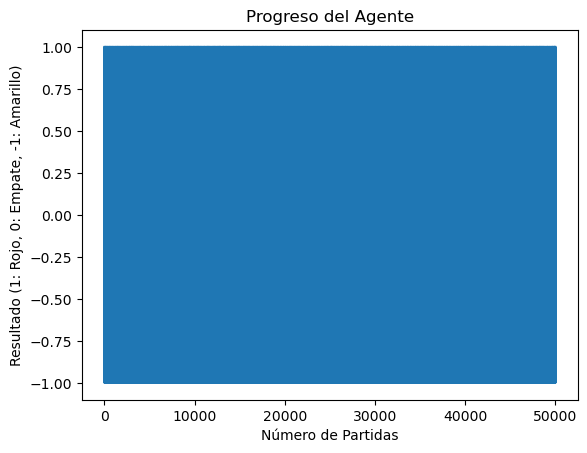

In [1]:
import numpy as np
import pickle
import random
from collections import defaultdict, deque
import matplotlib.pyplot as plt

class Ambiente:
    def __init__(self):
        self.rows = 6
        self.columns = 7
        self.reset()

    def reset(self):
        self.board = np.zeros((self.rows, self.columns), dtype=int)
        self.turn = 1  # 1 para el agente rojo, -1 para el agente amarillo
        self.moves_made = 0
        self.done = False
        self.winner = None

    def is_valid_move(self, column):
        return self.board[0][column] == 0

    def get_valid_moves(self):
        return [col for col in range(self.columns) if self.is_valid_move(col)]

    def play_move(self, column):
        if not self.is_valid_move(column):
            return False
        for row in range(self.rows -1, -1, -1):
            if self.board[row][column] == 0:
                self.board[row][column] = self.turn
                self.moves_made += 1
                break
        if self.check_winner(row, column):
            self.done = True
            self.winner = self.turn
        elif self.is_draw():
            self.done = True
            self.winner = 0
        else:
            self.switch_turn()
        return True

    def switch_turn(self):
        self.turn *= -1

    def check_winner(self, row, col):
        # Check horizontal
        count = 0
        for c in range(self.columns):
            if self.board[row][c] == self.turn:
                count += 1
                if count == 4:
                    return True
            else:
                count = 0
        # Check vertical
        count = 0
        for r in range(self.rows):
            if self.board[r][col] == self.turn:
                count += 1
                if count == 4:
                    return True
            else:
                count = 0
        # Check positive diagonal
        count = 0
        r, c = row, col
        while r > 0 and c > 0:
            r -= 1
            c -= 1
        while r < self.rows and c < self.columns:
            if self.board[r][c] == self.turn:
                count += 1
                if count == 4:
                    return True
            else:
                count = 0
            r += 1
            c += 1
        # Check negative diagonal
        count =0
        r, c = row, col
        while r < self.rows - 1 and c > 0:
            r += 1
            c -= 1
        while r >= 0 and c < self.columns:
            if self.board[r][c] == self.turn:
                count +=1
                if count == 4:
                    return True
            else:
                count =0
            r -= 1
            c += 1
        return False

    def is_draw(self):
        return self.moves_made == self.rows * self.columns

    def get_state(self):
        return tuple(map(tuple, self.board))

    def mirror_board(self):
        return tuple(map(tuple, np.fliplr(self.board)))

    def flip_vertical(self):
        return tuple(map(tuple, np.flipud(self.board)))

    def get_partial_view(self):
        # Retorna una vista parcial del tablero (por ejemplo, las columnas centrales)
        return tuple(map(tuple, self.board[:, 2:5]))

class Agente:
    def __init__(self, turn, gamma=0.95, lr=0.1):
        self.turn = turn  # 1 para rojo, -1 para amarillo
        self.q_table = {}
        self.gamma = gamma
        self.lr = lr
        self.epsilon = 1.0
        self.epsilon_decay = 0.9999
        self.epsilon_min = 0.05
        self.experience_replay = deque(maxlen=50000)
        self.batch_size = 64
    
    def get_state(self, env):
        state = env.get_state()
        # Generar versiones simétricas del estado
        mirrored_state = env.mirror_board()
        # Elegir una representación canónica (por ejemplo, la que tenga el hash más pequeño)
        canonical_state = min(state, mirrored_state)
        if canonical_state not in self.q_table:
            self.q_table[canonical_state] = [0] * env.columns
        return canonical_state
    
    def choose_action(self, env):
        state = self.get_state(env)
        if random.uniform(0, 1) < self.epsilon:
            return random.choice(env.get_valid_moves())
        else:
            return self.get_best_action(state, env)

    def get_best_action(self, state, env):
        valid_moves = env.get_valid_moves()
        q_values = self.q_table[state]
        q_values_valid = [q_values[i] if i in valid_moves else -float('inf') for i in range(env.columns)]
        max_q = max(q_values_valid)
        best_actions = [i for i, q in enumerate(q_values_valid) if q == max_q]
        return random.choice(best_actions)

    def update_q_value(self, state, action, reward, next_state, done):
        if next_state not in self.q_table:
            self.q_table[next_state] = [0] * env.columns
        max_future_q = max(self.q_table[next_state]) if not done else 0
        current_q = self.q_table[state][action]
        new_q = current_q + self.lr * (reward + self.gamma * max_future_q - current_q)
        self.q_table[state][action] = new_q

    def store_experience(self, state, action, reward, next_state, done):
        self.experience_replay.append((state, action, reward, next_state, done))

    def replay_experience(self):
        if len(self.experience_replay) < self.batch_size:
            return
        minibatch = random.sample(self.experience_replay, self.batch_size)
        for state, action, reward, next_state, done in minibatch:
            self.update_q_value(state, action, reward, next_state, done)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

    def save_q_table(self, file_name):
        with open(file_name, 'wb') as f:
            pickle.dump(self.q_table, f)

def jugar_partida(agente_rojo, agente_amarillo, env):
    env.reset()
    agentes = [agente_rojo, agente_amarillo]
    turno = 0  # 0 para rojo, 1 para amarillo

    while not env.done:
        agente_actual = agentes[turno]
        state = agente_actual.get_state(env)
        action = agente_actual.choose_action(env)
        env.play_move(action)
        next_state = agente_actual.get_state(env)
        done = env.done
        reward = 0
        if done:
            if env.winner == agente_actual.turn:
                reward = 10  # Victoria
            elif env.winner == 0:
                reward = 5   # Empate
            else:
                reward = -10  # Derrota
            agente_actual.update_q_value(state, action, reward, next_state, done)
            agente_actual.store_experience(state, action, reward, next_state, done)
            break
        else:
            # Recompensa intermedia puede ser ajustada
            reward = 0
            agente_actual.update_q_value(state, action, reward, next_state, done)
            agente_actual.store_experience(state, action, reward, next_state, done)
        turno = 1 - turno  # Cambia de turno

    # Actualiza experiencia para ambos agentes
    agente_rojo.replay_experience()
    agente_amarillo.replay_experience()

if __name__ == "__main__":
    env = Ambiente()
    agente_rojo = Agente(turn=1)
    agente_amarillo = Agente(turn=-1)

    partidas = 50000
    resultados = []
    victorias_rojo = 0
    victorias_amarillo = 0
    empates = 0

    for i in range(partidas):
        jugar_partida(agente_rojo, agente_amarillo, env)
        if env.winner == 1:
            victorias_rojo += 1
            resultados.append(1)
        elif env.winner == -1:
            victorias_amarillo += 1
            resultados.append(-1)
        else:
            empates += 1
            resultados.append(0)
        if (i + 1) % 1000 == 0:
            print(f"Partida {i + 1}/{partidas} completada.")
            print(f"Victorias Rojo: {victorias_rojo}, Victorias Amarillo: {victorias_amarillo}, Empates: {empates}")
            victorias_rojo = victorias_amarillo = empates = 0

    agente_rojo.save_q_table("q_table_rojo.pkl")
    agente_amarillo.save_q_table("q_table_amarillo.pkl")

    # Graficar los resultados
    plt.plot(resultados)
    plt.xlabel('Número de Partidas')
    plt.ylabel('Resultado (1: Rojo, 0: Empate, -1: Amarillo)')
    plt.title('Progreso del Agente')
    plt.show()


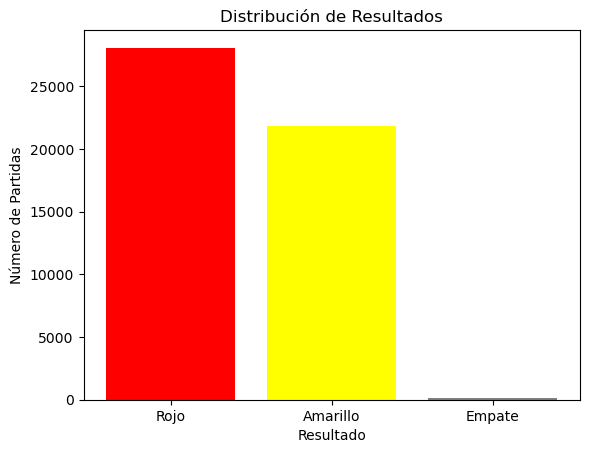

In [2]:
import matplotlib.pyplot as plt

# Contar y graficar resultados
victorias_rojo = resultados.count(1)
victorias_amarillo = resultados.count(-1)
empates = resultados.count(0)
# Crear gráfico de barras
labels = ['Rojo', 'Amarillo', 'Empate']
values = [victorias_rojo, victorias_amarillo, empates]
plt.bar(labels, values, color=['red', 'yellow', 'gray'])
plt.title('Distribución de Resultados')
plt.xlabel('Resultado')
plt.ylabel('Número de Partidas')
plt.show()

In [3]:
import pickle

# Cargar el archivo .pkl
with open('q_table_rojo.pkl', 'rb') as file:
    data = pickle.load(file)

# Mostrar el contenido del archivo
print(data)

{((0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0)): [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], ((0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 1, 0, 0)): [0, 0, 0, 0, 0, 0, 0], ((0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (-1, 0, 0, 0, 1, 0, 0)): [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], ((0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (-1, 0, 1, 0, 1, 0, 0)): [0, 0, 0, 0, 0, 0, 0], ((0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, -1, 0, 0, 0, 0), (0, 0, 1, 0, 1, 0, -1)): [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], ((0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, 0, 0, 0, 0, 0), (0, 0, -1, 0, 0, 0, 0), (0, 0, 1, 0, 1, 1, -1

In [3]:
print("Número de estados en la Q-table:", len(agente_rojo.q_table))

Número de estados en la Q-table: 670914


In [4]:
import tkinter as tk
import numpy as np
import pickle
import random
from tkinter import messagebox

class Ambiente:
    def __init__(self):
        self.rows = 6
        self.columns = 7
        self.reset()

    def reset(self):
        self.board = np.zeros((self.rows, self.columns))
        self.turn = 1
        self.moves_made = 0
        self.done = False

    def is_valid_move(self, column):
        return self.board[0][column] == 0

    def get_valid_moves(self):
        return [col for col in range(self.columns) if self.is_valid_move(col)]

    def play_move(self, column):
        if not self.is_valid_move(column):
            return False
        for row in range(self.rows - 1, -1, -1):
            if self.board[row][column] == 0:
                self.board[row][column] = self.turn
                self.moves_made += 1
                break
        return True

    def switch_turn(self):
        self.turn *= -1

    def check_winner(self):
        for c in range(self.columns - 3):
            for r in range(self.rows):
                if np.abs(np.sum(self.board[r, c:c + 4])) == 4:
                    return True
        for c in range(self.columns):
            for r in range(self.rows - 3):
                if np.abs(np.sum(self.board[r:r + 4, c])) == 4:
                    return True
        for c in range(self.columns - 3):
            for r in range(self.rows - 3):
                if np.abs(np.sum([self.board[r + i, c + i] for i in range(4)])) == 4:
                    return True
                if np.abs(np.sum([self.board[r + 3 - i, c + i] for i in range(4)])) == 4:
                    return True
        return False

    def is_draw(self):
        return self.moves_made == self.rows * self.columns

class Agente:
    def __init__(self, epsilon=0.05):
        self.q_table = {}
        self.epsilon = epsilon

    def load_q_table(self, file_name):
        with open(file_name, 'rb') as f:
            self.q_table = pickle.load(f)

    def get_state(self, env):
        return tuple(map(tuple, env.board))

    def choose_action(self, env):
        state = self.get_state(env)
        if random.uniform(0, 1) < self.epsilon:
            return random.choice(env.get_valid_moves())
        elif state in self.q_table:
            return self.get_best_action(state, env)
        else:
            return random.choice(env.get_valid_moves())

    def get_best_action(self, state, env):
        valid_moves = env.get_valid_moves()
        q_values = np.array(self.q_table.get(state, [0] * env.columns))
        q_values[~np.isin(range(env.columns), valid_moves)] = -1e6
        return np.argmax(q_values)

class Connect4GUI:
    def __init__(self, env, agente_rojo=None):
        self.env = env
        self.agente_rojo = agente_rojo
        self.turn = "yellow"
        self.window = tk.Tk()
        self.window.title("Conecta 4 - Humano (Amarillo) vs. Agente (Rojo)")

        self.buttons = [
            tk.Button(self.window, text="▼", font=("Arial", 16, "bold"), bg="gold", command=lambda c=i: self.human_move(c))
            for i in range(self.env.columns)
        ]
        for i, button in enumerate(self.buttons):
            button.grid(row=0, column=i, sticky="nsew", padx=2, pady=2)

        self.canvas = tk.Canvas(self.window, width=self.env.columns * 100, height=self.env.rows * 100, bg="#1E90FF")
        self.canvas.grid(row=1, column=0, columnspan=self.env.columns, padx=5, pady=5)
        self.circles = [[self.canvas.create_oval(j * 100 + 10, i * 100 + 10, j * 100 + 90, i * 100 + 90, fill="white") for j in range(self.env.columns)] for i in range(self.env.rows)]

        for i in range(self.env.columns):
            self.window.grid_columnconfigure(i, weight=1)
        self.window.grid_rowconfigure(1, weight=1)

    def disable_buttons(self):
        for button in self.buttons:
            button.config(state=tk.DISABLED)

    def enable_buttons(self):
        for button in self.buttons:
            button.config(state=tk.NORMAL)

    def human_move(self, column):
        if self.turn != "yellow" or not self.env.is_valid_move(column):
            return
        self.execute_move(column, "yellow", "¡Ganaste!")
        self.switch_turn()

    def agent_play(self):
        if self.turn != "red" or not self.agente_rojo:
            return
        action = self.agente_rojo.choose_action(self.env)
        self.execute_move(action, "red", "¡El agente rojo ha ganado!")
        self.switch_turn()

    def execute_move(self, column, color, win_message):
        self.env.play_move(column)
        row = next(r for r in range(self.env.rows) if self.env.board[r][column] != 0)
        self.canvas.itemconfig(self.circles[row][column], fill=color)
        if self.env.check_winner():
            messagebox.showinfo("Fin del juego", win_message)
            self.reset_game()
        elif self.env.is_draw():
            messagebox.showinfo("Fin del juego", "¡Es un empate!")
            self.reset_game()

    def switch_turn(self):
        self.env.switch_turn()
        self.turn = "yellow" if self.turn == "red" else "red"
        if self.turn == "yellow":
            self.enable_buttons()
        else:
            self.disable_buttons()
            self.window.after(500, self.agent_play)

    def reset_game(self):
        self.env.reset()
        self.turn = "yellow"
        for i in range(self.env.rows):
            for j in range(self.env.columns):
                self.canvas.itemconfig(self.circles[i][j], fill="white")
        self.enable_buttons()

    def run(self):
        self.window.mainloop()

if __name__ == "__main__":
    env = Ambiente()
    agente_rojo = Agente()
    agente_rojo.load_q_table("q_table_rojo.pkl")
    gui = Connect4GUI(env, agente_rojo)
    gui.run()


2024-11-14 08:58:36.143 python[2513:64184] +[IMKClient subclass]: chose IMKClient_Modern
2024-11-14 08:58:36.143 python[2513:64184] +[IMKInputSession subclass]: chose IMKInputSession_Modern
